In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cufflinks as cf
from statsmodels.graphics.tsaplots import plot_acf
cf.go_offline()

# GPU code

In [20]:
gpue=pd.read_csv("gpue.csv")
gpue

,t,Potential,Kinetic,Total,Virial
0,50,13358.1,620607,633965,1331330.0
1,100,13358.3,620607,633966,1331340.0
2,150,13358.6,620606,633966,1331340.0
3,200,13359.0,620606,633966,1331350.0
4,250,13359.5,620606,633966,1331360.0
...,...,...,...,...,...
28702,1435150,130774.0,502902,633674,4375490.0
28703,1435200,130777.0,502898,633675,4375580.0
28704,1435250,130781.0,502895,633676,4375660.0
28705,1435300,130784.0,502892,633675,4375740.0


In [21]:
gpue.iplot(x='t',y=['Kinetic','Potential','Total'],theme='white', xTitle='time', yTitle='Energy')

In [198]:
gpue['Error'] = gpue.apply(lambda row: (row.Total-gpue['Total'][0])/gpue['Total'][0], axis=1)
gpue.iplot(x='t', y='Error', theme='white', xTitle='time', yTitle='Energy error')

In [199]:
gpue.iplot(x='t', y='Virial', theme='white', xTitle='time', yTitle='Virial')

In [17]:
gpuparam = pd.read_csv("../research/pressure/cut/new/nocut.csv")
gpuparam

,P,V,T
0,155.185745,4096,101.009636
1,155.194855,4096,101.007744
2,155.209869,4096,101.005241
3,155.230011,4096,101.001381
4,155.255920,4096,100.996590
...,...,...,...
19994,257.290527,4096,82.372498
19995,257.303101,4096,82.370361
19996,257.315033,4096,82.368080
19997,257.326477,4096,82.365631


In [18]:
gpuparam.iplot(y=['P','V','T'],theme='white')

In [9]:
print(gpuparam['P'].loc[10000:20000].mean())
print(gpuparam['P'].loc[10000:20000].std(""))


nan


ValueError: No axis named  for object type <class 'pandas.core.series.Series'>

In [19]:
gpuparam.iplot(y='P', theme='white')

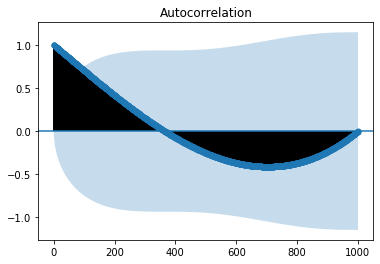

In [204]:
#gpuparam['P'].plot()
#each timestep is 10 time the previous one
plot_acf(gpuparam['P'].loc[500:1500], lags = 1000, alpha = 0.05)
plt.show()

In [205]:
gpuv = pd.read_csv("gpuv.csv")
gpuv

,vx,vy,vz,v
0,2.540400,0.953424,-0.498943,7.61157
1,-0.518478,-0.194238,3.335870,11.43460
2,1.093280,-1.617710,-3.017260,12.91610
3,-0.004793,-1.918590,3.784430,18.00290
4,-2.039210,-1.599230,0.114376,6.72899
...,...,...,...,...
507,-1.158950,1.519360,0.122367,3.66661
508,-1.155050,0.315522,-0.762629,2.01530
509,0.583866,-1.279700,-0.823174,2.65616
510,-1.509590,0.301517,0.640718,2.78029


In [206]:
gpuv.iplot(subplots=True, subplot_titles=True, legend=False, kind='histogram', theme='white')